# NLP With Hotel Review Part 1

Written by: Thai Nguyen

LinkedIn/Github: @thai22011

Date: Nov 11, 2022

## EDA

In [220]:
# Import the libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import math
import geopandas
import geopy

# Feature Engineering
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import MultiLabelBinarizer
from sklearn.preprocessing import MinMaxScaler
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import f_classif
from sklearn.feature_extraction.text import CountVectorizer

# Modelling
from sklearn.model_selection import train_test_split
import nltk
import string
from nltk.corpus import stopwords
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.linear_model import LogisticRegression

### 1. The target column of interest is `Reviewer_Score`

In [2]:
# Load the dataset then put it into a DF
hotel_df = pd.read_csv('data/Hotel_Reviews.csv')
hotel_df.head()

,Hotel_Address,Additional_Number_of_Scoring,Review_Date,Average_Score,Hotel_Name,Reviewer_Nationality,Negative_Review,Review_Total_Negative_Word_Counts,Total_Number_of_Reviews,Positive_Review,Review_Total_Positive_Word_Counts,Total_Number_of_Reviews_Reviewer_Has_Given,Reviewer_Score,Tags,days_since_review,lat,lng
0,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,8/3/2017,7.7,Hotel Arena,Russia,I am so angry that i made this post available...,397,1403,Only the park outside of the hotel was beauti...,11,7,2.9,"[' Leisure trip ', ' Couple ', ' Duplex Double...",0 days,52.360576,4.915968
1,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,8/3/2017,7.7,Hotel Arena,Ireland,No Negative,0,1403,No real complaints the hotel was great great ...,105,7,7.5,"[' Leisure trip ', ' Couple ', ' Duplex Double...",0 days,52.360576,4.915968
2,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,7/31/2017,7.7,Hotel Arena,Australia,Rooms are nice but for elderly a bit difficul...,42,1403,Location was good and staff were ok It is cut...,21,9,7.1,"[' Leisure trip ', ' Family with young childre...",3 days,52.360576,4.915968
3,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,7/31/2017,7.7,Hotel Arena,United Kingdom,My room was dirty and I was afraid to walk ba...,210,1403,Great location in nice surroundings the bar a...,26,1,3.8,"[' Leisure trip ', ' Solo traveler ', ' Duplex...",3 days,52.360576,4.915968
4,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,7/24/2017,7.7,Hotel Arena,New Zealand,You When I booked with your company on line y...,140,1403,Amazing location and building Romantic setting,8,3,6.7,"[' Leisure trip ', ' Couple ', ' Suite ', ' St...",10 days,52.360576,4.915968


#### 1a. Shape of the dataset

In [3]:
# Shape of the dataset
hotel_df.shape

(515738, 17)

The dataset contains 515,738 rows and 17 columns.

#### 1b. Converting `Reviewer_Score` to integers

In [4]:
# Check for detype of Reviewer_Score
hotel_df['Reviewer_Score'].dtype

dtype('float64')

In [5]:
# Convert the Reviewer_Score to int32
hotel_df['Reviewer_Score'].astype('int32')

0         2
1         7
2         7
3         3
4         6
         ..
515733    7
515734    5
515735    2
515736    8
515737    8
Name: Reviewer_Score, Length: 515738, dtype: int32

A quick check show that converted the `Reviewer_Score` to `int32` automatically ignore all the decimals which caused the final results to be less than the original value ie. 2.8 (float64) to 2 (int32). Thus, it is important to round the values to the nearest integer under float64 before converting to int32.

In [6]:
# Round the Reviewer_Score to the nearest integer FIRST 
hotel_df['Reviewer_Score'] = hotel_df['Reviewer_Score'].round()
print(hotel_df['Reviewer_Score'])

0         3.0
1         8.0
2         7.0
3         4.0
4         7.0
         ... 
515733    7.0
515734    6.0
515735    2.0
515736    9.0
515737    8.0
Name: Reviewer_Score, Length: 515738, dtype: float64


In [7]:
# Now, convert the Reviewer_Score to int32
hotel_df['Reviewer_Score'] = hotel_df['Reviewer_Score'].astype('int32')
print(hotel_df['Reviewer_Score'])

0         3
1         8
2         7
3         4
4         7
         ..
515733    7
515734    6
515735    2
515736    9
515737    8
Name: Reviewer_Score, Length: 515738, dtype: int32


#### 1c. Expectation and the actual distribution of `Reviewer_Score`

Expectation of the Ditribution of scores: To know the distribution without ploting the distribution chart, find the `mean` of the `Reviewer_Score`

Skewness and methods to normalize the dataset
-  https://medium.com/@TheDataGyan/day-8-data-transformation-skewness-normalization-and-much-more-4c144d370e55
- https://towardsdatascience.com/top-3-methods-for-handling-skewed-data-1334e0debf45

In [8]:
hotel_df['Reviewer_Score'].mean()

8.45757729699964

The mean is 8.45 so let's plot the distribution of the reviews, assumingthe most reviews would be around 8-9

In [9]:
# Plot the Reviewer_Score for distribution

fig = px.histogram(data_frame = hotel_df, x='Reviewer_Score', title ='Distribution of Reviewer_Score')
fig.show()

In [10]:
hotel_df['Reviewer_Score'].skew()

-1.2179006193634636

The actualy distribution of `Reviewer_Score` is __left skewed__ ( Negative Skeweness = -1.22) toward 10, with the mean is 8.45

There are a few other tests to verify whether the distribution is NOT normal.
 - Jarque-Bera Test (p>0.05 dataset follow normal distribution)
 - Kolmogorov-Smirnov test (p>0.05 dataset follow normal distribution)
 - Shapiro- Wilk test (p>0.05 dataset follow normal distribution)

 Let's try these test and compares the results on the `Reviewer_Score`

In [11]:
from scipy.stats import jarque_bera
from scipy.stats import kstest
from scipy.stats import shapiro

result_jb = (jarque_bera(hotel_df['Reviewer_Score']))
print(f"Jarque-Bera Test, {result_jb}")

result_ks = (kstest(hotel_df['Reviewer_Score'], cdf='norm'))
print(f"Kolmogorov-Smirnov Test, {result_ks}")

result_sw = (shapiro(hotel_df['Reviewer_Score']))
print(f"Shapiro-Wilk Test, {result_sw}")

Jarque-Bera Test, Jarque_beraResult(statistic=155984.23935620196, pvalue=0.0)
Kolmogorov-Smirnov Test, KstestResult(statistic=0.9943863091123073, pvalue=0.0)
Shapiro-Wilk Test, ShapiroResult(statistic=0.8347299695014954, pvalue=0.0)


c:\Users\ethai\anaconda3\envs\timeseries\lib\site-packages\scipy\stats\_morestats.py:1800: UserWarning:

p-value may not be accurate for N > 5000.



Since these p-values are < 0.05, the dataset does not follow a normal distribution

In [12]:
# Convert the data to log to decrease skewness >>> only useful with right skew. not left skew. shown below
test1 = np.log(hotel_df['Reviewer_Score'])
fig = px.histogram(data_frame = test1, x='Reviewer_Score', title ='Distribution of Reviewer_Score log')
fig.show()

The method above using log to convert the skewed data into log form to reduce skewness. However, research showed that this method is applicable to right skewed only. The data above is still skewed after applying the log method.

#### 1d. Issue with distribution

The studies on classification of dataset assume relatively normal distribution. However, class imbalance in skewed dataset is quite common in real world applications; thus, applying machine learning models from skewed dataset resutls in BIASED Classification towarding the majority class which results in misclassification of minority class.

### 2. Data Cleaning

#### 2a. Checking for numeric and non-numeric columns

In [13]:
# Check for dtypes of columns using info
hotel_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 515738 entries, 0 to 515737
Data columns (total 17 columns):
 #   Column                                      Non-Null Count   Dtype  
---  ------                                      --------------   -----  
 0   Hotel_Address                               515738 non-null  object 
 1   Additional_Number_of_Scoring                515738 non-null  int64  
 2   Review_Date                                 515738 non-null  object 
 3   Average_Score                               515738 non-null  float64
 4   Hotel_Name                                  515738 non-null  object 
 5   Reviewer_Nationality                        515738 non-null  object 
 6   Negative_Review                             515738 non-null  object 
 7   Review_Total_Negative_Word_Counts           515738 non-null  int64  
 8   Total_Number_of_Reviews                     515738 non-null  int64  
 9   Positive_Review                             515738 non-null  object 
 

In [14]:
# List all numeric columns
# Using 'exclude=object' to only keep numeric dtype
hotel_df.select_dtypes(exclude='object').columns.tolist()

['Additional_Number_of_Scoring',
 'Average_Score',
 'Review_Total_Negative_Word_Counts',
 'Total_Number_of_Reviews',
 'Review_Total_Positive_Word_Counts',
 'Total_Number_of_Reviews_Reviewer_Has_Given',
 'Reviewer_Score',
 'lat',
 'lng']

In [15]:
# List all non-numeric columns
hotel_df.select_dtypes(include='object').columns.tolist()

['Hotel_Address',
 'Review_Date',
 'Hotel_Name',
 'Reviewer_Nationality',
 'Negative_Review',
 'Positive_Review',
 'Tags',
 'days_since_review']

In [16]:
# Check all non-numeric columns
hotel_df.select_dtypes(include='object').head(5)

,Hotel_Address,Review_Date,Hotel_Name,Reviewer_Nationality,Negative_Review,Positive_Review,Tags,days_since_review
0,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,8/3/2017,Hotel Arena,Russia,I am so angry that i made this post available...,Only the park outside of the hotel was beauti...,"[' Leisure trip ', ' Couple ', ' Duplex Double...",0 days
1,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,8/3/2017,Hotel Arena,Ireland,No Negative,No real complaints the hotel was great great ...,"[' Leisure trip ', ' Couple ', ' Duplex Double...",0 days
2,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,7/31/2017,Hotel Arena,Australia,Rooms are nice but for elderly a bit difficul...,Location was good and staff were ok It is cut...,"[' Leisure trip ', ' Family with young childre...",3 days
3,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,7/31/2017,Hotel Arena,United Kingdom,My room was dirty and I was afraid to walk ba...,Great location in nice surroundings the bar a...,"[' Leisure trip ', ' Solo traveler ', ' Duplex...",3 days
4,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,7/24/2017,Hotel Arena,New Zealand,You When I booked with your company on line y...,Amazing location and building Romantic setting,"[' Leisure trip ', ' Couple ', ' Suite ', ' St...",10 days


It is possible to turn some non-numeric columns into numeric such as `Review_Date`, `Reviewer_Nationality`, `Hotel_Name`, and `days_since_review`, `Tags`

#### 2b. Checking duplicated values

In [17]:
# Check for duplicated rows
hotel_df.duplicated().value_counts()/hotel_df.shape[0]*100

False    99.89801
True      0.10199
dtype: float64

The duplicated rows is 0.1% of the dataframe. It is safe to drop the duplicated without affecting the modelling

In [18]:
# Drop the duplicated rows
hotel_df.drop_duplicates(inplace=True)

In [19]:
# Double check for duplicated
hotel_df.duplicated().value_counts()

False    515212
dtype: int64

#### 2c. Checking empty fields

In [20]:
# Check for missing values
hotel_df.isna().sum()

Hotel_Address                                    0
Additional_Number_of_Scoring                     0
Review_Date                                      0
Average_Score                                    0
Hotel_Name                                       0
Reviewer_Nationality                             0
Negative_Review                                  0
Review_Total_Negative_Word_Counts                0
Total_Number_of_Reviews                          0
Positive_Review                                  0
Review_Total_Positive_Word_Counts                0
Total_Number_of_Reviews_Reviewer_Has_Given       0
Reviewer_Score                                   0
Tags                                             0
days_since_review                                0
lat                                           3268
lng                                           3268
dtype: int64

In [21]:
# Check for Hotel_Address that have missing values
h_address = hotel_df[hotel_df['lat'].isna()]['Hotel_Address'].unique()
h_address

array(['20 Rue De La Ga t 14th arr 75014 Paris France',
       '23 Rue Damr mont 18th arr 75018 Paris France',
       '4 rue de la P pini re 8th arr 75008 Paris France',
       'Bail n 4 6 Eixample 08010 Barcelona Spain',
       'Gr nentorgasse 30 09 Alsergrund 1090 Vienna Austria',
       'Hasenauerstra e 12 19 D bling 1190 Vienna Austria',
       'Josefst dter Stra e 10 12 08 Josefstadt 1080 Vienna Austria',
       'Josefst dter Stra e 22 08 Josefstadt 1080 Vienna Austria',
       'Landstra er G rtel 5 03 Landstra e 1030 Vienna Austria',
       'Paragonstra e 1 11 Simmering 1110 Vienna Austria',
       'Pau Clar s 122 Eixample 08009 Barcelona Spain',
       'Savoyenstra e 2 16 Ottakring 1160 Vienna Austria',
       'Sep lveda 180 Eixample 08011 Barcelona Spain',
       'Sieveringer Stra e 4 19 D bling 1190 Vienna Austria',
       'Taborstra e 8 A 02 Leopoldstadt 1020 Vienna Austria',
       'W hringer Stra e 12 09 Alsergrund 1090 Vienna Austria',
       'W hringer Stra e 33 35 09 Als

The above unique addresses are all the address that have missing lat and lon. Geopy is a great tool to find the lat and lon from an address. However, the addresses above have unreadable string. To use Geopy, only Zip code, City and Country will be extracted and feed into Geopy-Geocoder, some dupplicated zips will occur due to the addresses are in the same zip. However, the duplicated zip is assumed to be insignicant to the result 

In [22]:
# Import the geocoder from geopy to find lat and lon from an address (need to have geopy libraries first, use 'conda install geopy' in git-bash)
from geopy.geocoders import Nominatim
import re
# Nominatim is like Google Map, need to clarify user_agent = 'an app' to use their service
geolocator = Nominatim(user_agent='my-app')

# Create a for loop for every h_address above, however, only use the Zip code, Ciy and Country
for i in h_address:

    # Extract Zip, City, Country using Regex from h_address, then save it to a dataframe
    # \d{4,}\s\w{4,}\s\w{3,} is the regex that extract 4+-zip code number, space, city, space and country
    address = [x.strip() for x in re.findall(r"\d{4,}\s\w{4,}\s\w{3,}", i)]

    #Using geolocator.geocode the code from geopy to find lat and lon from 'address' dataframe
    location = geolocator.geocode(address)

    # Use the .latitude and .longitude to find the cooridnates, then save it to separate dataframe
    lat = location.latitude
    lon = location.longitude

    # fill NA values with lat and lon from the geocoder for each Hotel_Address
    hotel_df.loc[hotel_df['Hotel_Address'] == i] =\
    hotel_df[hotel_df['Hotel_Address'] == i].fillna({'lat':lat, 'lng': lon})

    print(f'The lat and lon for {address} are {lat}, {lon}')


The lat and lon for ['75014 Paris France'] are 48.83052451793961, 2.325218905683837
The lat and lon for ['75018 Paris France'] are 48.8886874893303, 2.3438434695800225
The lat and lon for ['75008 Paris France'] are 48.87231454822064, 2.3109288987544483
The lat and lon for ['08010 Barcelona Spain'] are 41.39152340720524, 2.174633664847162
The lat and lon for ['1090 Vienna Austria'] are 48.2224143, 16.3535872
The lat and lon for ['1190 Vienna Austria'] are 48.245581, 16.342038
The lat and lon for ['1080 Vienna Austria'] are 48.2093747, 16.3507157
The lat and lon for ['1080 Vienna Austria'] are 48.2093747, 16.3507157
The lat and lon for ['1030 Vienna Austria'] are 48.186776550000005, 16.40296978170732
The lat and lon for ['1110 Vienna Austria'] are 48.1857192, 16.4221587
The lat and lon for ['08009 Barcelona Spain'] are 41.39475095079872, 2.169321853035144
The lat and lon for ['1160 Vienna Austria'] are 48.1658192, 16.5043852
The lat and lon for ['08011 Barcelona Spain'] are 41.3843998778

In [23]:
# Re-check the fill values
for i in h_address:
    display(hotel_df[hotel_df['Hotel_Address']==i][['Hotel_Address', 'lat','lng']].head(2))

,Hotel_Address,lat,lng
99488,20 Rue De La Ga t 14th arr 75014 Paris France,48.830525,2.325219
99489,20 Rue De La Ga t 14th arr 75014 Paris France,48.830525,2.325219


,Hotel_Address,lat,lng
116738,23 Rue Damr mont 18th arr 75018 Paris France,48.888687,2.343843
116739,23 Rue Damr mont 18th arr 75018 Paris France,48.888687,2.343843


,Hotel_Address,lat,lng
177657,4 rue de la P pini re 8th arr 75008 Paris France,48.872315,2.310929
177658,4 rue de la P pini re 8th arr 75008 Paris France,48.872315,2.310929


,Hotel_Address,lat,lng
282265,Bail n 4 6 Eixample 08010 Barcelona Spain,41.391523,2.174634
282266,Bail n 4 6 Eixample 08010 Barcelona Spain,41.391523,2.174634


,Hotel_Address,lat,lng
327680,Gr nentorgasse 30 09 Alsergrund 1090 Vienna Au...,48.222414,16.353587
327681,Gr nentorgasse 30 09 Alsergrund 1090 Vienna Au...,48.222414,16.353587


,Hotel_Address,lat,lng
338919,Hasenauerstra e 12 19 D bling 1190 Vienna Austria,48.245581,16.342038
338920,Hasenauerstra e 12 19 D bling 1190 Vienna Austria,48.245581,16.342038


,Hotel_Address,lat,lng
351449,Josefst dter Stra e 10 12 08 Josefstadt 1080 V...,48.209375,16.350716
351450,Josefst dter Stra e 10 12 08 Josefstadt 1080 V...,48.209375,16.350716


,Hotel_Address,lat,lng
352107,Josefst dter Stra e 22 08 Josefstadt 1080 Vien...,48.209375,16.350716
352108,Josefst dter Stra e 22 08 Josefstadt 1080 Vien...,48.209375,16.350716


,Hotel_Address,lat,lng
365418,Landstra er G rtel 5 03 Landstra e 1030 Vienna...,48.186777,16.40297
365419,Landstra er G rtel 5 03 Landstra e 1030 Vienna...,48.186777,16.40297


,Hotel_Address,lat,lng
395735,Paragonstra e 1 11 Simmering 1110 Vienna Austria,48.185719,16.422159
395736,Paragonstra e 1 11 Simmering 1110 Vienna Austria,48.185719,16.422159


,Hotel_Address,lat,lng
401983,Pau Clar s 122 Eixample 08009 Barcelona Spain,41.394751,2.169322
401984,Pau Clar s 122 Eixample 08009 Barcelona Spain,41.394751,2.169322


,Hotel_Address,lat,lng
440791,Savoyenstra e 2 16 Ottakring 1160 Vienna Austria,48.165819,16.504385
440792,Savoyenstra e 2 16 Ottakring 1160 Vienna Austria,48.165819,16.504385


,Hotel_Address,lat,lng
449422,Sep lveda 180 Eixample 08011 Barcelona Spain,41.3844,2.158941
449423,Sep lveda 180 Eixample 08011 Barcelona Spain,41.3844,2.158941


,Hotel_Address,lat,lng
449450,Sieveringer Stra e 4 19 D bling 1190 Vienna Au...,48.245581,16.342038
449451,Sieveringer Stra e 4 19 D bling 1190 Vienna Au...,48.245581,16.342038


,Hotel_Address,lat,lng
465289,Taborstra e 8 A 02 Leopoldstadt 1020 Vienna Au...,48.232488,16.415505
465290,Taborstra e 8 A 02 Leopoldstadt 1020 Vienna Au...,48.232488,16.415505


,Hotel_Address,lat,lng
499956,W hringer Stra e 12 09 Alsergrund 1090 Vienna ...,48.222414,16.353587
499957,W hringer Stra e 12 09 Alsergrund 1090 Vienna ...,48.222414,16.353587


,Hotel_Address,lat,lng
500179,W hringer Stra e 33 35 09 Alsergrund 1090 Vien...,48.222414,16.353587
500180,W hringer Stra e 33 35 09 Alsergrund 1090 Vien...,48.222414,16.353587


In [24]:
# Re-Check if there is any na
hotel_df.isna().sum()

Hotel_Address                                 0
Additional_Number_of_Scoring                  0
Review_Date                                   0
Average_Score                                 0
Hotel_Name                                    0
Reviewer_Nationality                          0
Negative_Review                               0
Review_Total_Negative_Word_Counts             0
Total_Number_of_Reviews                       0
Positive_Review                               0
Review_Total_Positive_Word_Counts             0
Total_Number_of_Reviews_Reviewer_Has_Given    0
Reviewer_Score                                0
Tags                                          0
days_since_review                             0
lat                                           0
lng                                           0
dtype: int64

#### 2d. Checking for blank spaces

Some clients would submited a blank reviews with review score, if the blank reviews have 'space' or weird character, the system won't be able to detect them using .isna(). Let's further investigage if this is the case

In [25]:
# Find all blank spaces in cells
np.sum(hotel_df == ' ')

Hotel_Address                                   0
Additional_Number_of_Scoring                    0
Review_Date                                     0
Average_Score                                   0
Hotel_Name                                      0
Reviewer_Nationality                          522
Negative_Review                               849
Review_Total_Negative_Word_Counts               0
Total_Number_of_Reviews                         0
Positive_Review                               182
Review_Total_Positive_Word_Counts               0
Total_Number_of_Reviews_Reviewer_Has_Given      0
Reviewer_Score                                  0
Tags                                            0
days_since_review                               0
lat                                             0
lng                                             0
dtype: int64

Some suggestions to prevent this from happening:
 - Convert the `Reviewer_Nationality` into a drop-down menu so reviewers can select their nationalities instead of filling out the cell.
 - Require reviews columns to be a minimum of 5 words so reviewers cannot submit a blank review

# Data Wrangling

### 3. Build a proper dataset seperation

Due to the size of the dataset, a 8% sample size will be used to build all the codes for the dataset. Then, once the codes are built, a final run will be performed on the main dataset

In [26]:
# Select 12% sample from the dataset then save it to a new dataframe
hotel_df3 = hotel_df.sample(frac = 0.08)
hotel_df3 = hotel_df3.reset_index(drop=True)

# Check the new dataframe
hotel_df3

,Hotel_Address,Additional_Number_of_Scoring,Review_Date,Average_Score,Hotel_Name,Reviewer_Nationality,Negative_Review,Review_Total_Negative_Word_Counts,Total_Number_of_Reviews,Positive_Review,Review_Total_Positive_Word_Counts,Total_Number_of_Reviews_Reviewer_Has_Given,Reviewer_Score,Tags,days_since_review,lat,lng
0,Passeig Colom 12 Ciutat Vella 08002 Barcelona ...,156,12/21/2015,8.9,Duquesa de Cardona,Qatar,No Negative,0,904,Breakfast to be included for the residents,8,1,7,"[' Business trip ', ' Solo traveler ', ' Class...",591 day,41.379866,2.180527
1,2 Stanhope Row Park Lane Westminster Borough L...,444,1/19/2017,7.0,Park Lane Mews Hotel,United Kingdom,rooms are too small,6,2061,No Positive,0,2,8,"[' Leisure trip ', ' Couple ', ' Double Room '...",196 day,51.505933,-0.148942
2,Albert Cuypstraat 2 6 Oud Zuid 1072 CT Amsterd...,181,7/21/2016,8.8,Sir Albert Hotel,Spain,No Negative,0,1068,Great hotel very well located and good value ...,31,1,10,"[' Leisure trip ', ' Couple ', ' Double Room '...",378 day,52.354451,4.887504
3,Stephansplatz 9 01 Innere Stadt 1010 Vienna Au...,62,5/27/2017,9.3,Hotel Am Stephansplatz,India,No Negative,0,520,Simple and no fuss,5,2,10,"[' Business trip ', ' Solo traveler ', ' Junio...",68 days,48.208765,16.372114
4,Rembrandtplein 26 36 Amsterdam City Center 101...,224,3/12/2017,7.7,NH Amsterdam Schiller,United Kingdom,The only problem we had was the lift door the...,37,1667,the hotel is set in a great location with ple...,69,9,10,"[' Leisure trip ', ' Couple ', ' Standard Doub...",144 day,52.365709,4.896691
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41212,1 Inverness Terrace Westminster Borough London...,1274,7/10/2017,7.7,Grand Royale London Hyde Park,United Kingdom,The room was very small and quite shabby and ...,69,6539,Good breakfast A beautiful old building full ...,14,1,5,"[' Leisure trip ', ' Couple ', ' Superior Doub...",24 days,51.510995,-0.186342
41213,43 51 Wembley Hill Road Brent London HA9 8AU U...,540,10/8/2016,8.9,St George s Hotel Wembley,United Kingdom,booking arrangement via booking com,6,2274,Very friendly staff they couldn t help more A...,40,3,9,"[' Business trip ', ' Group ', ' 2 rooms ', ' ...",299 day,51.555368,-0.286494
41214,27 Devonshire Terrace Westminster Borough Lond...,1243,6/21/2016,8.1,Park Grand Paddington Court,United Kingdom,Bit of a hike from the tube at Paddington,11,6608,Comfortable and well appointed Well placed fo...,13,11,9,"[' Leisure trip ', ' Couple ', ' Deluxe Double...",408 day,51.513556,-0.180002
41215,22 Portman Square Westminster Borough London W...,597,6/14/2017,7.9,Radisson Blu Portman Hotel London,United Arab Emirates,Room size,3,2308,Great location,3,1,8,"[' Leisure trip ', ' Couple ', ' Superior Room...",50 days,51.516191,-0.157949


#### 3a. Binary Conversion on the Reviewer_Score

Reviews that are below 9 should be encoded as 0 ('not good') and reviews with scores 9 and 10 as 1 ('good').

In [27]:
# Convert Reviewer_Score to binary data
hotel_df3['Reviewer_Score'] =np.where(hotel_df3['Reviewer_Score'] < 9 , 0, 1)

# Check the conversion
hotel_df3[['Reviewer_Score']].value_counts()

Reviewer_Score
1                 23472
0                 17745
dtype: int64

#### 3b. Converting the interested non-numeric columns into numeric columns

In [28]:
# Assign to a new dataframe to easy to work with
hotel_df3b = hotel_df3

# Review all the non-numeric columns
hotel_df3b.select_dtypes(include='object').columns.tolist()

['Hotel_Address',
 'Review_Date',
 'Hotel_Name',
 'Reviewer_Nationality',
 'Negative_Review',
 'Positive_Review',
 'Tags',
 'days_since_review']

All of the non-numeric columns will be converted to numeric columns using either one of the following options:
- label encoding
- one-hot encoding
- datetime conversion
- numeric extraction & conversion

##### 3.b. Hotel_Address - LabelEncoding

This process will extract cities and countries from the Hotel_Address then assign them to the new columns

In [29]:
# Extract countries and save to a new column
hotel_df3b['Country'] = hotel_df3b['Hotel_Address'].str.split(' ').str[-1]

# Check 
hotel_df3b['Country'].value_counts()

Kingdom        20980
France          4852
Spain           4807
Netherlands     4543
Austria         3066
Italy           2969
Name: Country, dtype: int64

In [30]:
# Convert 'Kingdom' to UK
hotel_df3b['Country'] = hotel_df3b['Country'].replace('Kingdom', 'UK')

# Check
hotel_df3b['Country'].value_counts()

UK             20980
France          4852
Spain           4807
Netherlands     4543
Austria         3066
Italy           2969
Name: Country, dtype: int64

In [31]:
# Extract Cities and save to a new column
hotel_df3b['City'] = hotel_df3b['Hotel_Address'].str.split(' ').str[-2]

# Check 
hotel_df3b['City'].value_counts()

United       20980
Paris         4852
Barcelona     4807
Amsterdam     4543
Vienna        3066
Milan         2969
Name: City, dtype: int64

In [32]:
# Extract Cities in the UK
# Result show that London was the only city in the UK in the dataset (London had the same value counts as the UK)
hotel_df3b['Hotel_Address'].str.split(' ').str[-5].value_counts()

London       20980
Center        1926
Ciutat        1271
City          1083
Innere         974
             ...  
670              2
34               1
108              1
Fauch            1
Palmanova        1
Name: Hotel_Address, Length: 173, dtype: int64

In [33]:
# Convert 'United' in City to London
hotel_df3b['City'] = hotel_df3b['City'].replace('United', 'London')

# Check
hotel_df3b['City'].value_counts()

London       20980
Paris         4852
Barcelona     4807
Amsterdam     4543
Vienna        3066
Milan         2969
Name: City, dtype: int64

In [34]:
# Label Encoding COUNTRY
# Instantiate the label encoder
le_country = LabelEncoder()

# Fit and transform the order priority column
le_country_array = le_country.fit_transform(hotel_df3b['Country'])

# Put into a dataframe to get column names
le_country_df = pd.DataFrame(le_country_array, columns=['Country_LE'], dtype=int)

# Drop Country in the main column
#hotel_df3b = hotel_df3b.drop(columns='Country')

# Concat the new df to the main df
hotel_df3b = pd.concat([hotel_df3b, le_country_df], axis=1)

In [35]:
# Label Encoding CITY 
# There is a high possibility of multi-collinearity between City and Country, Use this with caution
# Instantiate the label encoder
le_city = LabelEncoder()

# Fit and transform the order priority column
le_city_array = le_city.fit_transform(hotel_df3b['City'])

# Put into a dataframe to get column names
le_city_df = pd.DataFrame(le_city_array, columns=['City_LE'], dtype=int)

# Concat the new df to the main df
# DO NOT RUN MULTIPLE TIMES, OR THEY KEEP ADDING THE COLUMNS
hotel_df3b = pd.concat([hotel_df3b, le_city_df], axis=1)

# Reference check then drop the original columns
hotel_df3b[['Country', 'City', 'Country_LE', 'City_LE']].value_counts()

Country      City       Country_LE  City_LE
UK           London     5           2          20980
France       Paris      1           4           4852
Spain        Barcelona  4           1           4807
Netherlands  Amsterdam  3           0           4543
Austria      Vienna     0           5           3066
Italy        Milan      2           3           2969
dtype: int64

Due to the fact that there was only 1 city per country, there are a HIGH correlation and could cause multi-collinearity between Country and City. Therefore, Home_Address and City (including City_LE) should be dropped and not converted to binary data if using LogRegression or other model that depends on independent variables.

In [36]:
# Drop Hotel_Address, Country and City in the main column
hotel_df3b = hotel_df3b.drop(columns=['Hotel_Address','Country', 'City'])

##### 3b. Review_Date - Converting to datetime64

In [37]:
# Check the Review_Date Column
hotel_df3b['Review_Date']

0        12/21/2015
1         1/19/2017
2         7/21/2016
3         5/27/2017
4         3/12/2017
            ...    
41212     7/10/2017
41213     10/8/2016
41214     6/21/2016
41215     6/14/2017
41216     8/16/2016
Name: Review_Date, Length: 41217, dtype: object

In [38]:
# Convert to datetime using Pandas then save tho the orginial column
hotel_df3b['Review_Date'] = pd.to_datetime(hotel_df3b['Review_Date'])

# Check column
hotel_df3b['Review_Date']

0       2015-12-21
1       2017-01-19
2       2016-07-21
3       2017-05-27
4       2017-03-12
           ...    
41212   2017-07-10
41213   2016-10-08
41214   2016-06-21
41215   2017-06-14
41216   2016-08-16
Name: Review_Date, Length: 41217, dtype: datetime64[ns]

##### 3b. Hotel_Name - Label Encoding

In [39]:
# Review the Hotel_Name
hotel_df3b['Hotel_Name'].value_counts()

Strand Palace Hotel                                  376
Britannia International Hotel Canary Wharf           373
Park Plaza Westminster Bridge London                 318
Copthorne Tara Hotel London Kensington               274
DoubleTree by Hilton Hotel London Tower of London    258
                                                    ... 
Hotel G tico                                           1
Lansbury Heritage Hotel                                1
H tel Le Royal Monceau Raffles Paris                   1
AC Hotel Irla a Marriott Lifestyle Hotel               1
Prince de Galles a Luxury Collection hotel Paris       1
Name: Hotel_Name, Length: 1472, dtype: int64

In [40]:
# Label Encoding Hotel_Name 
# Instantiate the label encoder
le_hotel_name = LabelEncoder()

# Fit and transform the order priority column
le_hotel_name_array = le_hotel_name.fit_transform(hotel_df3b['Hotel_Name'])

# Put into a dataframe to get column names
le_hotel_name_df = pd.DataFrame(le_hotel_name_array, columns=['Hotel_Name_LE'], dtype=int)

# Concat the new df to the main df
hotel_df3b = pd.concat([hotel_df3b, le_hotel_name_df], axis=1)

# Reference check then drop the original columns
hotel_df3b[['Hotel_Name', 'Hotel_Name_LE']].value_counts()

Hotel_Name                                         Hotel_Name_LE
Strand Palace Hotel                                1272             376
Britannia International Hotel Canary Wharf         184              373
Park Plaza Westminster Bridge London               1130             318
Copthorne Tara Hotel London Kensington             239              274
DoubleTree by Hilton Hotel London Tower of London  280              258
                                                                   ... 
Hotel G tico                                       629                1
Renaissance Paris Vendome Hotel                    1181               1
Room Mate Gerard                                   1191               1
Bulgari Hotel London                               187                1
H tel France d Antin Op ra                         423                1
Length: 1472, dtype: int64

In [41]:
# Drop Hotel_Name in the main column
hotel_df3b = hotel_df3b.drop(columns=['Hotel_Name'])

##### 3b. Reviewer_Nationality - Label Enconding

In [42]:
# Review the Hotel_Name
hotel_df3b['Reviewer_Nationality'].value_counts()

 United Kingdom               19531
 United States of America      2874
 Australia                     1714
 Ireland                       1204
 United Arab Emirates           809
                              ...  
 British Virgin Islands           1
 U S Virgin Islands               1
 Gabon                            1
 Yemen                            1
 Papua New Guinea                 1
Name: Reviewer_Nationality, Length: 173, dtype: int64

In [43]:
# Check for blank in Reviewer_Nationality
# This is a 12% sample
hotel_df3b[hotel_df3b['Reviewer_Nationality'] == ' ']['Reviewer_Nationality'].value_counts()

     38
Name: Reviewer_Nationality, dtype: int64

In [44]:
# Assign unknown to blank Reviewer_Nationality
hotel_df3b['Reviewer_Nationality'] = hotel_df3b['Reviewer_Nationality'].replace(' ', 'Unknown')

# Check
hotel_df3b[hotel_df3b['Reviewer_Nationality'] == 'Unknown']['Reviewer_Nationality'].value_counts()

Unknown    38
Name: Reviewer_Nationality, dtype: int64

In [45]:
# Label Encoding Reviewer_Nationality
# Instantiate the label encoder
le_nationality = LabelEncoder()

# Fit and transform the order priority column
le_nationality_array = le_nationality.fit_transform(hotel_df3b['Reviewer_Nationality'])

# Put into a dataframe to get column names
le_nationality_df = pd.DataFrame(le_nationality_array, columns=['Reviewer_Nationality_LE'], dtype=int)

# Concat the new df to the main df
hotel_df3b = pd.concat([hotel_df3b, le_nationality_df], axis=1)

# Reference check then drop the original columns
hotel_df3b[['Reviewer_Nationality', 'Reviewer_Nationality_LE']].value_counts()

Reviewer_Nationality        Reviewer_Nationality_LE
 United Kingdom             162                        19531
 United States of America   164                         2874
 Australia                  11                          1714
 Ireland                    72                          1204
 United Arab Emirates       161                          809
                                                       ...  
 Rwanda                     132                            1
 Madagascar                 95                             1
 British Virgin Islands     27                             1
 Burundi                    30                             1
 Saint Kitts and Nevis      133                            1
Length: 173, dtype: int64

In [46]:
# Drop Reviewer_Nationality in the main column
hotel_df3b = hotel_df3b.drop(columns='Reviewer_Nationality')

##### 3b. days_since_review - Numeric Extraction and Conversion

In [47]:
# Review the days_since_review column
hotel_df3b['days_since_review'].value_counts()

1 days     189
120 day    170
387 day    167
322 day    163
429 day    155
          ... 
587 day     12
503 day     12
243 day     10
124 day      9
615 day      7
Name: days_since_review, Length: 731, dtype: int64

In [48]:
# Extract the numberic value then save to the main columns
hotel_df3b['days_since_review'] = hotel_df3b['days_since_review'].str.extract('(\d+)')

# Convert the columns to int64
hotel_df3b['days_since_review'] = hotel_df3b['days_since_review'].astype('int64')

# Review the column again 
hotel_df3b['days_since_review']

0        591
1        196
2        378
3         68
4        144
        ... 
41212     24
41213    299
41214    408
41215     50
41216    352
Name: days_since_review, Length: 41217, dtype: int64

In [49]:
# Check dtype
hotel_df3b['days_since_review'].dtype

dtype('int64')

##### 3b. Tags - MultiLabelBinarizer

In [50]:
# Review the Tags column
hotel_df3b['Tags'].value_counts()

[' Leisure trip ', ' Couple ', ' Double Room ', ' Stayed 1 night ', ' Submitted from a mobile device ']                               386
[' Leisure trip ', ' Couple ', ' Standard Double Room ', ' Stayed 1 night ', ' Submitted from a mobile device ']                      378
[' Leisure trip ', ' Couple ', ' Superior Double Room ', ' Stayed 1 night ', ' Submitted from a mobile device ']                      337
[' Leisure trip ', ' Couple ', ' Deluxe Double Room ', ' Stayed 1 night ', ' Submitted from a mobile device ']                        335
[' Leisure trip ', ' Couple ', ' Double Room ', ' Stayed 2 nights ', ' Submitted from a mobile device ']                              256
                                                                                                                                     ... 
[' Leisure trip ', ' Couple ', ' King Hilton Plaza Room ', ' Stayed 5 nights ', ' Submitted from a mobile device ']                     1
[' Business trip ', ' Family with 

In [51]:
# These are called a nested list or series of lists in a dataframe
# Regex will search for 5 words first, going down - start with 5 words, then 4 words, then 3 words, then 2 words, then 1 word by using \s\w{1,} repeating
# this sequence will make sure long words don't get cut off
list_3b = hotel_df3b['Tags'].str.findall(r'\s\w{1,}\s\w{1,}\s\w{1,}\s\w{1,}\s\w{1,}|\s\w{1,}\s\w{1,}\s\w{1,}\s\w{1,}|\s\w{1,}\s\w{1,}\s\w{1,}|\s\w{1,}\s\w{1,}|\s\w{1,}')

# Check
list_3b

0        [ Business trip,  Solo traveler,  Classic Doub...
1        [ Leisure trip,  Couple,  Double Room,  Stayed...
2        [ Leisure trip,  Couple,  Double Room,  Stayed...
3        [ Business trip,  Solo traveler,  Junior Suite...
4        [ Leisure trip,  Couple,  Standard Double or T...
                               ...                        
41212    [ Leisure trip,  Couple,  Superior Double Room...
41213    [ Business trip,  Group,  2 rooms,  Stayed 1 n...
41214    [ Leisure trip,  Couple,  Deluxe Double Room, ...
41215    [ Leisure trip,  Couple,  Superior Room,  Stay...
41216    [ Leisure trip,  Couple,  Superior Room with S...
Name: Tags, Length: 41217, dtype: object

In [52]:
#MultiLabelBinarizer
lb = MultiLabelBinarizer()

list_3b_df = pd.DataFrame(lb.fit_transform(list_3b), columns=lb.classes_, dtype=int)

list_3b_df

,1 2 Adults,1 Adult,1 Child,1 King Bed Guest Room,1 child,2 Adjacent Non Communicating Rooms,2 Adjacent Rooms,2 Adjacent Superior Rooms,2 Adults,2 Adults 1 Child,...,with Sauna Access,with Sea View,with Spa Access,with Spa Bath,with Terrace,with Terrace Spa acces,with Terrace and Spa Access,with VIP Services,with View,with extra bed
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41212,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
41213,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
41214,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
41215,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [71]:
# Concat the new df to the main df
hotel_df3b = pd.concat([hotel_df3b, list_3b_df], axis=1)

In [54]:
# Drop the Reference column
hotel_df3b = hotel_df3b.drop(columns='Tags')

In [55]:
#Check
hotel_df3b

,Additional_Number_of_Scoring,Review_Date,Average_Score,Negative_Review,Review_Total_Negative_Word_Counts,Total_Number_of_Reviews,Positive_Review,Review_Total_Positive_Word_Counts,Total_Number_of_Reviews_Reviewer_Has_Given,Reviewer_Score,days_since_review,lat,lng,Country_LE,City_LE,Hotel_Name_LE,Reviewer_Nationality_LE
0,156,2015-12-21,8.9,No Negative,0,904,Breakfast to be included for the residents,8,1,0,591,41.379866,2.180527,4,1,295,128
1,444,2017-01-19,7.0,rooms are too small,6,2061,No Positive,0,2,0,196,51.505933,-0.148942,5,2,1121,162
2,181,2016-07-21,8.8,No Negative,0,1068,Great hotel very well located and good value ...,31,1,1,378,52.354451,4.887504,3,0,1241,142
3,62,2017-05-27,9.3,No Negative,0,520,Simple and no fuss,5,2,1,68,48.208765,16.372114,0,5,557,68
4,224,2017-03-12,7.7,The only problem we had was the lift door the...,37,1667,the hotel is set in a great location with ple...,69,9,1,144,52.365709,4.896691,3,0,1026,162
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41212,1274,2017-07-10,7.7,The room was very small and quite shabby and ...,69,6539,Good breakfast A beautiful old building full ...,14,1,0,24,51.510995,-0.186342,5,2,367,162
41213,540,2016-10-08,8.9,booking arrangement via booking com,6,2274,Very friendly staff they couldn t help more A...,40,3,1,299,51.555368,-0.286494,5,2,1257,162
41214,1243,2016-06-21,8.1,Bit of a hike from the tube at Paddington,11,6608,Comfortable and well appointed Well placed fo...,13,11,1,408,51.513556,-0.180002,5,2,1114,162
41215,597,2017-06-14,7.9,Room size,3,2308,Great location,3,1,0,50,51.516191,-0.157949,5,2,1166,161


##### 3b. Final check

This is a final check to ensure all non-numeric columns are converted to numeric columns EXCEPT the Negative and Positive Reviews columns. Also checkingto make sure if all newly created columns contains a value and not ONLY 0.

In [56]:
# Check dtype of columns
hotel_df3b.select_dtypes(include='object').columns.tolist()

['Negative_Review', 'Positive_Review']

In [57]:
hotel_df3b.select_dtypes(exclude='object').columns.tolist()

['Additional_Number_of_Scoring',
 'Review_Date',
 'Average_Score',
 'Review_Total_Negative_Word_Counts',
 'Total_Number_of_Reviews',
 'Review_Total_Positive_Word_Counts',
 'Total_Number_of_Reviews_Reviewer_Has_Given',
 'Reviewer_Score',
 'days_since_review',
 'lat',
 'lng',
 'Country_LE',
 'City_LE',
 'Hotel_Name_LE',
 'Reviewer_Nationality_LE']

In [58]:
# Check if any columns contains ONLY 0
# The result returned length = 1660 which is the same as length of the concatenated dataframe. 
# Thus, all the created columns have some values and not only 0.
hotel_df3b.any()

Additional_Number_of_Scoring                  True
Review_Date                                   True
Average_Score                                 True
Negative_Review                               True
Review_Total_Negative_Word_Counts             True
Total_Number_of_Reviews                       True
Positive_Review                               True
Review_Total_Positive_Word_Counts             True
Total_Number_of_Reviews_Reviewer_Has_Given    True
Reviewer_Score                                True
days_since_review                             True
lat                                           True
lng                                           True
Country_LE                                    True
City_LE                                       True
Hotel_Name_LE                                 True
Reviewer_Nationality_LE                       True
dtype: bool

#### 3c. Split the data into train and test sets.

In this step, the dataframe is separated to independent variables (X) and dependent variables (y). There are 1659 independent variables which need to be checked to see which variables are significant in the modeling. Other non-significant variables should be dropped to reduced noise and power consumption in the modeling.

In [86]:
# Apply KBest Selector and f_classif, finding the best k value and select best features
my_KBest = SelectKBest(f_classif, k=20).fit(hotel_df3b[hotel_df3b.columns.difference(['Average_Score', 'Review_Date', 'Negative_Review', 'Positive_Review'])], hotel_df3b['Average_Score'])

#get the names of the selected features
np.array(hotel_df3b[hotel_df3b.columns.difference(['Average_Score', 'Review_Date', 'Negative_Review', 'Positive_Review'])].columns)[my_KBest.get_support()]

array([' Cabin Single Room', ' Camper Room', ' Camper Suite',
       ' Deluxe Double', ' Deluxe Single Room',
       ' Deluxe Two Bedroom Apartment', ' Double Hilton Guestroom',
       ' Double Room with Shared Bathroom', ' Economy Twin Room',
       ' Grand Deluxe Double or Twin', ' Kings Junior Suite',
       ' Small Single Room', ' Standard Double',
       ' Standard Double Room without Window',
       ' Superior King or Twin Room', ' Superior Shard King',
       'Additional_Number_of_Scoring', 'Hotel_Name_LE', 'Reviewer_Score',
       'Total_Number_of_Reviews'], dtype=object)

Selecting the best features at k = 20 (own discretions) found 20 best features that affect the model predictions.

In [87]:
# Determine X and y variables
# Modeling cant run datetime, need to drop datetime
X = hotel_df3b[hotel_df3b.columns.difference(['Average_Score'])]
y = hotel_df3b['Average_Score']

In [88]:
# Split data to train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42)

#### 3d. Natural Language Processing: Bags-of-Words and TF-IDF

- Use a count vectorizer to combine Positive_Review and Negative_Review with the numeric data (notice that this is done AFTER the train/test split). 
- You should vectorize each column separately, ending up with two sparse matrixes, and then 
- Combine the three matrixes (numeric data, positive matrix, negative matrix). You may have to adjust the min_df parameter.

##### 3d. Negative_Review

Start the process by performing natural language processing (NLP) on the train and then test set of Negative_Review column without applying any conditions such as removing stopwords, punctuation, or performing stemming and lemmatization. 

In [185]:
# 1. Instantiate 
bagofwords_neg = CountVectorizer()

# 2. Fit 
bagofwords_neg.fit(X_train["Negative_Review"])

# 3. Transform
X_train_transformed_neg = bagofwords_negative.transform(X_train["Negative_Review"])
X_train_transformed_neg

<27615x13282 sparse matrix of type '<class 'numpy.int64'>'
	with 381491 stored elements in Compressed Sparse Row format>

In [115]:
bagofwords_negative.get_feature_names()

['00',
 '000',
 '001',
 '004',
 '007',
 '00am',
 '00h',
 '00pm',
 '01',
 '0100',
 '0130',
 '02',
 '028',
 '03',
 '033',
 '04',
 '05',
 '05pm',
 '06',
 '0600',
 '0630',
 '0650',
 '07',
 '0700',
 '08',
 '0810',
 '0830',
 '09',
 '0902',
 '0930',
 '10',
 '100',
 '1000',
 '1000am',
 '1001',
 '100gbp',
 '100m',
 '101',
 '102',
 '103',
 '104',
 '105',
 '106',
 '107',
 '108',
 '109',
 '10am',
 '10days',
 '10e',
 '10eur',
 '10euro',
 '10gbp',
 '10min',
 '10mins',
 '10minute',
 '10minutes',
 '10pm',
 '10pounds',
 '10sqm',
 '10th',
 '11',
 '110',
 '111',
 '112',
 '1123',
 '113',
 '1130',
 '114',
 '115',
 '117',
 '1183',
 '11a',
 '11am',
 '11despite',
 '11gbp',
 '11h',
 '11m2',
 '11pm',
 '11th',
 '12',
 '120',
 '1200hrs',
 '120m',
 '1219',
 '124',
 '1240',
 '125',
 '1269',
 '1271',
 '1277',
 '128k',
 '12am',
 '12h',
 '12noon',
 '12oclock',
 '12pm',
 '12th',
 '13',
 '130',
 '1308',
 '130euros',
 '132',
 '134',
 '135',
 '1365',
 '137',
 '138',
 '139',
 '13h',
 '13min',
 '13th',
 '14',
 '140',
 '1400

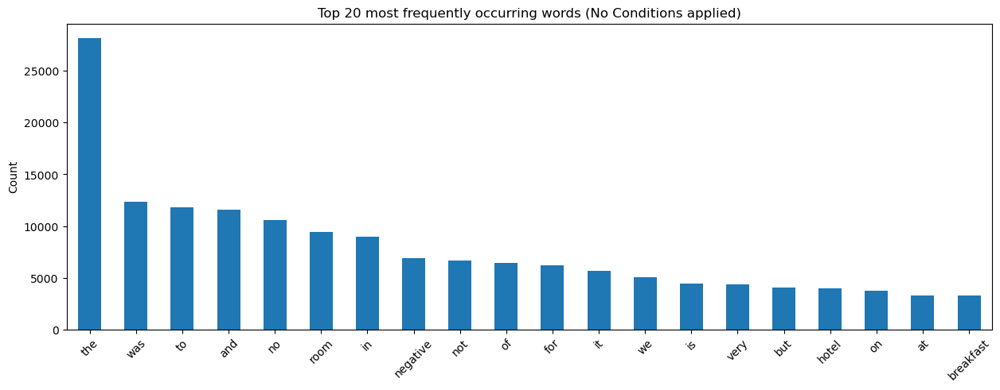

In [117]:
word_counts = pd.DataFrame(
    {"counts": X_train_transformed_neg.toarray().sum(axis=0)},
    index=bagofwords_negative.get_feature_names()
).sort_values("counts", ascending=False)

word_counts.head(20).plot(kind="bar", figsize=(15, 5), legend=False)
plt.title("Top 20 most frequently occurring words (No Conditions applied)")
plt.ylabel("Count")
plt.xticks(rotation=45)
plt.show()

The features got many stopwords, punctuation, random numbers and bad N-grams. Need to create a customized tokenizer function.

In [148]:
# Create a customized tokenizer
ENGLISH_STOP_WORDS = stopwords.words('english')

def my_tokenizer(sentence):
    # remove punctuation and set to lower case
    # string.punctuation is a STRING package that has a list of punctuation characters
    for punctuation_mark in string.punctuation:
        sentence = sentence.replace(punctuation_mark,'').lower()

    # split sentence into words
    listofwords = sentence.split(' ')
    listofstemmed_words = []
    
    # remove stopwords and any tokens that are just empty strings
    stemmer = nltk.stem.PorterStemmer()
    for word in listofwords:
        if (not word in ENGLISH_STOP_WORDS) and (word!=''):
            # Stem words
            stemmed_word = stemmer.stem(word)
            listofstemmed_words.append(stemmed_word)

    return listofstemmed_words

##### CountVectorizer - NEGATIVE

In [187]:
# CountVectorizer the  TRAIN Negative Review
# Select a min_df=1000, at own disretion to reduced the classes/variables
bagofwords = CountVectorizer(min_df=1000, # Reduce noise and cut down the classes
                             tokenizer=my_tokenizer,
                             ngram_range=(1, 10),
                             max_df=3000) # remove common words that occur like 'room' and 'neg'
bagofwords.fit(X_train["Negative_Review"])

X_train_transformed_neg = bagofwords.transform(X_train["Negative_Review"])
X_test_transformed_neg = bagofwords.transform(X_test["Negative_Review"])

X_train_transformed_neg.shape 

(27615, 21)

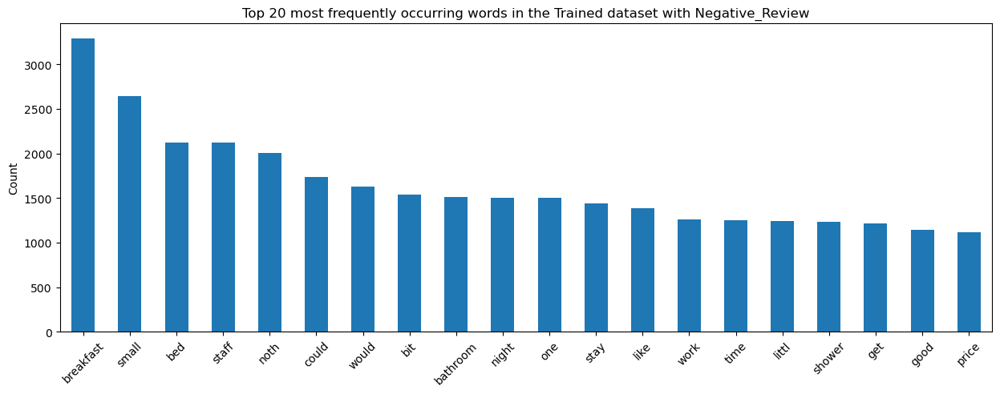

In [188]:
# Plot the top 20 frequesntly occuring words for TRAIN data 

word_counts = pd.DataFrame(
    {"counts": X_train_transformed_neg.toarray().sum(axis=0)},
    index=bagofwords.get_feature_names()
).sort_values("counts", ascending=False)

word_counts.head(20).plot(kind="bar", figsize=(15, 5), legend=False)
plt.title("Top 20 most frequently occurring words in the Trained dataset with Negative_Review")
plt.ylabel("Count")
plt.xticks(rotation=45)
plt.show()

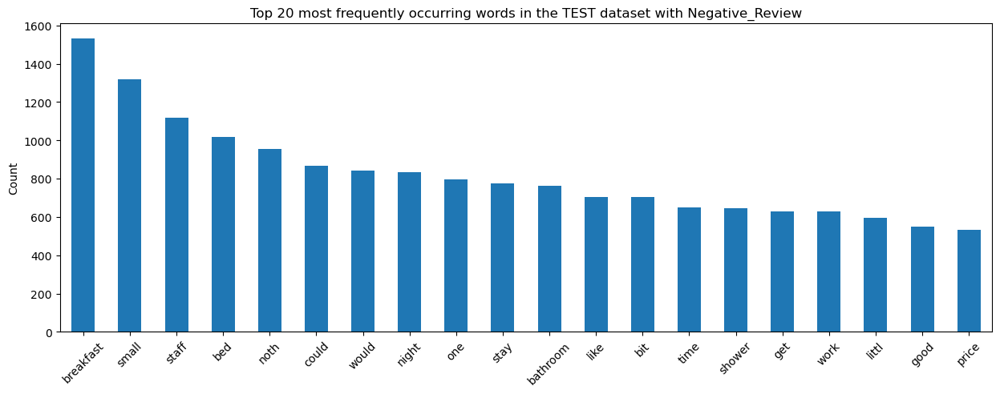

In [189]:
# Plot the top 20 frequesntly occuring words for TEST data 

word_counts = pd.DataFrame(
    {"counts": X_test_transformed_neg.toarray().sum(axis=0)},
    index=bagofwords.get_feature_names()
).sort_values("counts", ascending=False)

word_counts.head(20).plot(kind="bar", figsize=(15, 5), legend=False)
plt.title("Top 20 most frequently occurring words in the TEST dataset with Negative_Review")
plt.ylabel("Count")
plt.xticks(rotation=45)
plt.show()

For the Negative_Review Column, the model was able to predict the top 10 words in the test dataset which match the trained dataset. The top 20 words were similar with a slight different in the test dataset. Overall, reviewers gave negative reviews about the rooms, room size, breakfast, staff, bathroom

#### TF-IDF Vectorizer - NEGATIVE

To further investigate the Negative_Review, perform the TF-IDF Vectorization to see if the top 20 words changed

In [195]:
# Use TF-IDF Modeling

tfidf_neg = TfidfVectorizer(min_df=200,
                        tokenizer=my_tokenizer,
                        ngram_range=(1, 10),
                        max_df=500) # remove common words such as 'room', and 'neg'
tfidf_neg.fit(X_train["Negative_Review"])

X_train_transformed_neg_tfidf = tfidf_neg.transform(X_train["Negative_Review"])
X_test_transformed_neg_tfidf = tfidf_neg.transform(X_test["Negative_Review"])


c:\Users\ethai\anaconda3\envs\timeseries\lib\site-packages\sklearn\feature_extraction\text.py:489: UserWarning:

The parameter 'token_pattern' will not be used since 'tokenizer' is not None'



In [196]:
# Check shape of trained dataset
X_train_transformed_neg_tfidf.shape 

(27615, 170)

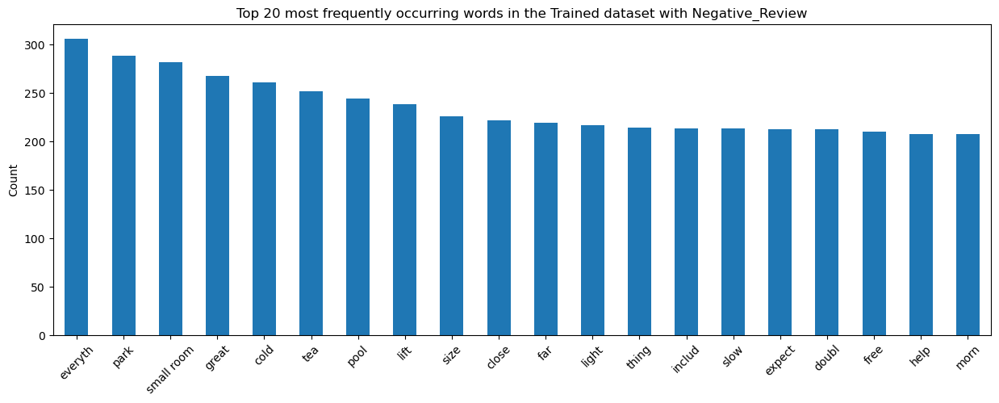

In [197]:
# Plot the top 20 frequesntly occuring words for TRAIN_ TFIDF 

word_counts = pd.DataFrame(
    {"counts": X_train_transformed_neg_tfidf.toarray().sum(axis=0)},
    index=tfidf_neg.get_feature_names()
).sort_values("counts", ascending=False)

word_counts.head(20).plot(kind="bar", figsize=(15, 5), legend=False)
plt.title("Top 20 most frequently occurring words in the Trained dataset with Negative_Review")
plt.ylabel("Count")
plt.xticks(rotation=45)
plt.show()

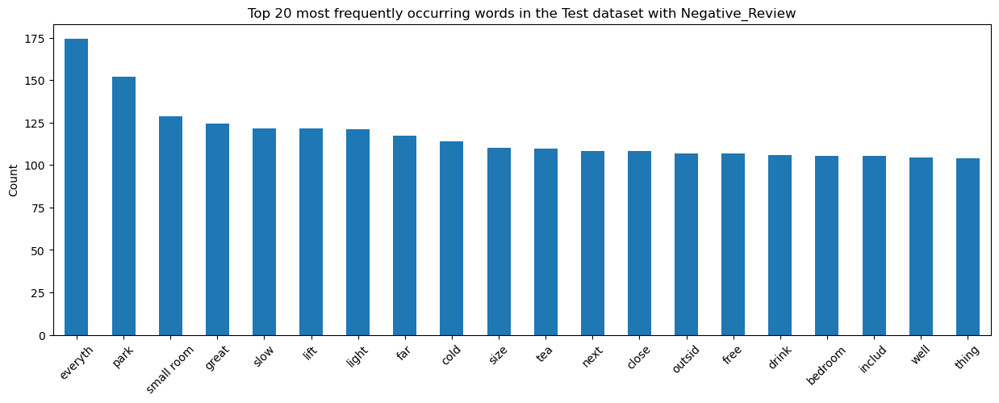

In [198]:
# Plot the top 20 frequesntly occuring words for TEST_TFIDF

word_counts = pd.DataFrame(
    {"counts": X_test_transformed_neg_tfidf.toarray().sum(axis=0)},
    index=tfidf_neg.get_feature_names()
).sort_values("counts", ascending=False)

word_counts.head(20).plot(kind="bar", figsize=(15, 5), legend=False)
plt.title("Top 20 most frequently occurring words in the Test dataset with Negative_Review")
plt.ylabel("Count")
plt.xticks(rotation=45)
plt.show()

Similar th CountVectorizer, most negative reviews in the TF-IDF was about roomsize, noisiness and wifi issues, although small room was emphasized more in the TF-IDF.

##### 3d. Positive_Review

Similar process like above but with the Positive_Review column. Performing NLP bag-of-words without conditions (customized tokenizer)

In [151]:
# 1. Instantiate 
bagofwords_pos = CountVectorizer()

# 2. Fit 
bagofwords_pos.fit(X_train["Positive_Review"])

# 3. Transform
X_train_transformed_pos = bagofwords_pos.transform(X_train["Positive_Review"])
X_train_transformed_pos

<27615x11231 sparse matrix of type '<class 'numpy.int64'>'
	with 372674 stored elements in Compressed Sparse Row format>

In [152]:
bagofwords_pos.get_feature_names()

['00',
 '00am',
 '00pm',
 '01',
 '02',
 '03',
 '05',
 '07',
 '0730',
 '08',
 '0m',
 '0people',
 '10',
 '100',
 '100m',
 '101',
 '103',
 '108',
 '10am',
 '10euro',
 '10euros',
 '10mbit',
 '10min',
 '10mins',
 '10minute',
 '10minutes',
 '10th',
 '11',
 '110',
 '111',
 '112',
 '1130',
 '116',
 '1183',
 '118mbps',
 '11am',
 '11jan017',
 '11jan2017',
 '11km',
 '11pm',
 '11th',
 '12',
 '120',
 '1200',
 '125',
 '12am',
 '12e',
 '12h',
 '12min',
 '12pm',
 '12th',
 '13',
 '130',
 '133',
 '135mbps',
 '13th',
 '13thnov',
 '14',
 '140',
 '140cm',
 '14h00',
 '14th',
 '15',
 '150',
 '1500',
 '151',
 '159',
 '15eur',
 '15euro',
 '15euros',
 '15m',
 '15min',
 '15mins',
 '15th',
 '16',
 '161',
 '1620',
 '16th',
 '17',
 '174',
 '17rh',
 '17th',
 '18',
 '1800',
 '1880s',
 '1898',
 '18mo',
 '18th',
 '19',
 '1900',
 '1930',
 '197',
 '1970',
 '1972',
 '199',
 '19h',
 '19th',
 '19y',
 '1am',
 '1hour',
 '1km',
 '1min',
 '1pm',
 '1st',
 '20',
 '200',
 '2009',
 '200m',
 '200yards',
 '2010',
 '2014',
 '2015',
 '

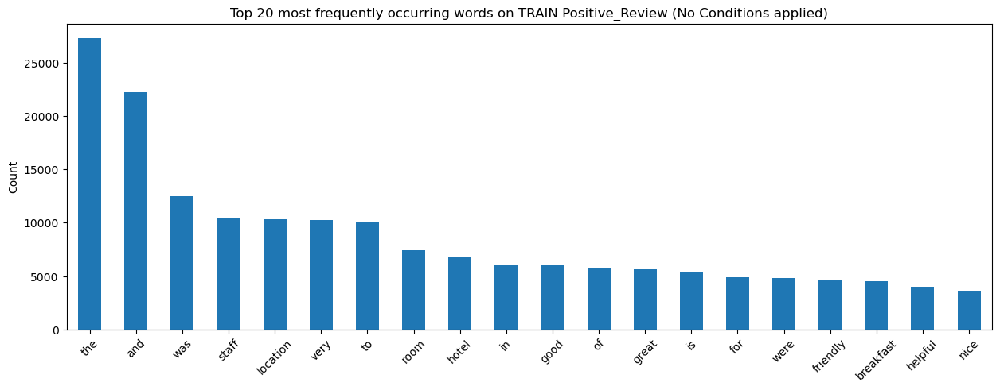

In [154]:
word_counts = pd.DataFrame(
    {"counts": X_train_transformed_pos.toarray().sum(axis=0)},
    index=bagofwords_pos.get_feature_names()
).sort_values("counts", ascending=False)

word_counts.head(20).plot(kind="bar", figsize=(15, 5), legend=False)
plt.title("Top 20 most frequently occurring words on TRAIN Positive_Review (No Conditions applied)")
plt.ylabel("Count")
plt.xticks(rotation=45)
plt.show()

The features got many stopwords, punctuation, random numbers and bad N-grams. Let's use the customized tokenizer = my_tokenizer from the function above

In [ ]:
# Create a customized tokenizer
ENGLISH_STOP_WORDS = stopwords.words('english')

def my_tokenizer(sentence):
    # remove punctuation and set to lower case
    # string.punctuation is a STRING package that has a list of punctuation characters
    for punctuation_mark in string.punctuation:
        sentence = sentence.replace(punctuation_mark,'').lower()

    # split sentence into words
    listofwords = sentence.split(' ')
    listofstemmed_words = []
    
    # remove stopwords and any tokens that are just empty strings
    stemmer = nltk.stem.PorterStemmer()
    for word in listofwords:
        if (not word in ENGLISH_STOP_WORDS) and (word!='') and (word != 'neg'):
            # Stem words
            stemmed_word = stemmer.stem(word)
            listofstemmed_words.append(stemmed_word)

    return listofstemmed_words

##### CountVectorizer - POSITIVE

In [159]:
# CountVectorizer the  TRAIN Negative Review
# Select a min_df=1000, at own disretion to reduced the classes/variables
# No need to use max_df as the result doesnt have stopwords unlike Negative_Review
bagofwords_pos = CountVectorizer(min_df=1000, # Reduced noise and classes
                             tokenizer=my_tokenizer,
                             ngram_range=(1, 10))
bagofwords_pos.fit(X_train["Positive_Review"])

X_train_transformed_pos = bagofwords_pos.transform(X_train["Positive_Review"])
X_test_transformed_pos = bagofwords_pos.transform(X_test["Positive_Review"])

X_train_transformed_neg.shape 

c:\Users\ethai\anaconda3\envs\timeseries\lib\site-packages\sklearn\feature_extraction\text.py:489: UserWarning:

The parameter 'token_pattern' will not be used since 'tokenizer' is not None'



(27615, 22)

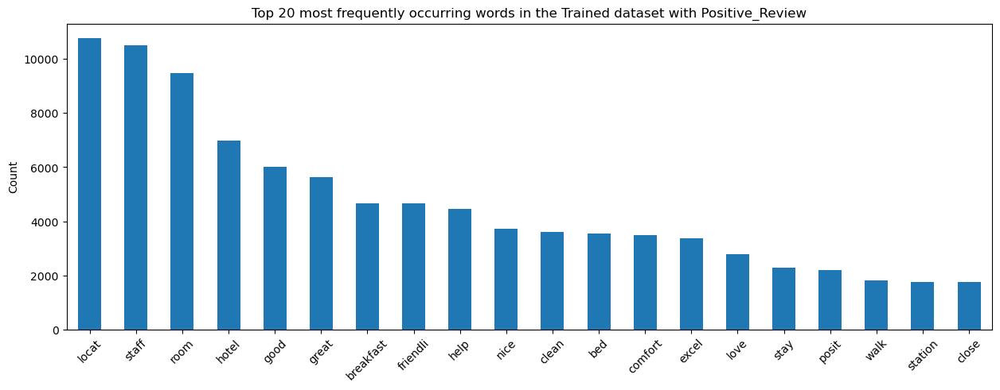

In [157]:
# Plot the top 20 frequesntly occuring words for TRAIN data 

word_counts = pd.DataFrame(
    {"counts": X_train_transformed_pos.toarray().sum(axis=0)},
    index=bagofwords_pos.get_feature_names()
).sort_values("counts", ascending=False)

word_counts.head(20).plot(kind="bar", figsize=(15, 5), legend=False)
plt.title("Top 20 most frequently occurring words in the Trained dataset with Positive_Review")
plt.ylabel("Count")
plt.xticks(rotation=45)
plt.show()

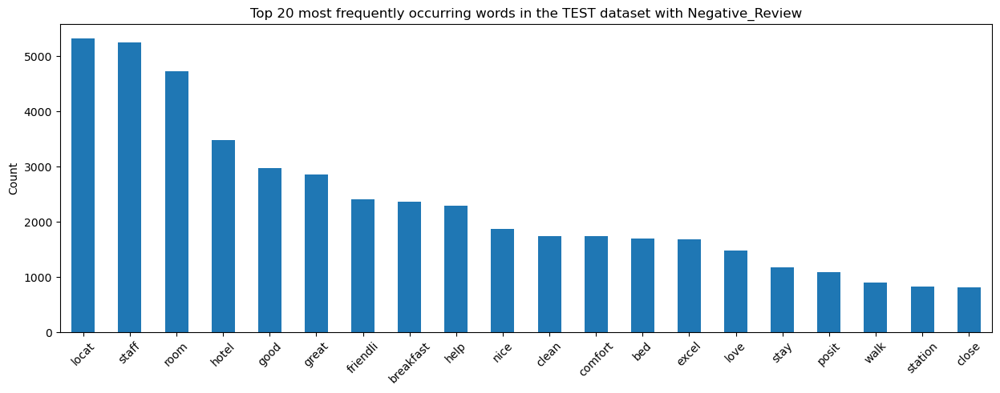

In [158]:
# Plot the top 20 frequesntly occuring words for TEST data 

word_counts = pd.DataFrame(
    {"counts": X_test_transformed_pos.toarray().sum(axis=0)},
    index=bagofwords_pos.get_feature_names()
).sort_values("counts", ascending=False)

word_counts.head(20).plot(kind="bar", figsize=(15, 5), legend=False)
plt.title("Top 20 most frequently occurring words in the TEST dataset with Negative_Review")
plt.ylabel("Count")
plt.xticks(rotation=45)
plt.show()

For the Positive_Review Column, the model had similar results for both test and train dataset. Positive reviews talked about location, staff, friendly, help, nice, clean, comfort, excel, love, positive, and close. These are all positive and complimentary words

#### TF-IDF Vectorizer - POSITIVE

To further investigate the Positive_Review, perform the TF-IDF Vectorization to see if the top 20 words changed

In [167]:
# Use TF-IDF Modeling
# No need to use max_df as the result doesnt have stopwords

tfidf_pos = TfidfVectorizer(min_df=100,
                        tokenizer=my_tokenizer,
                        ngram_range=(1, 10))
tfidf_pos.fit(X_train["Positive_Review"])

X_train_transformed_pos_tfidf = tfidf_pos.transform(X_train["Positive_Review"])
X_test_transformed_pos_tfidf = tfidf_pos.transform(X_test["Positive_Review"])


In [203]:
# Check shape of trained dataset
X_train_transformed_pos_tfidf.shape 

(27615, 567)

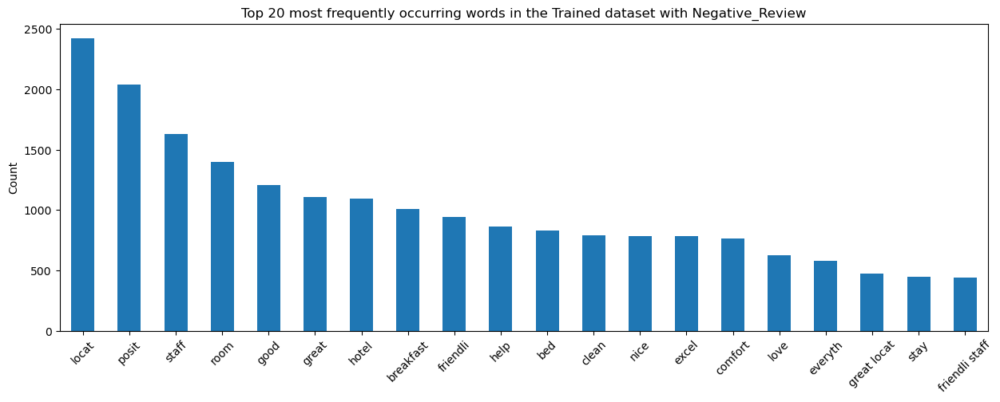

In [169]:
# Plot the top 20 frequesntly occuring words for TRAIN_ TFIDF 

word_counts = pd.DataFrame(
    {"counts": X_train_transformed_pos_tfidf.toarray().sum(axis=0)},
    index=tfidf_pos.get_feature_names()
).sort_values("counts", ascending=False)

word_counts.head(20).plot(kind="bar", figsize=(15, 5), legend=False)
plt.title("Top 20 most frequently occurring words in the Trained dataset with Negative_Review")
plt.ylabel("Count")
plt.xticks(rotation=45)
plt.show()

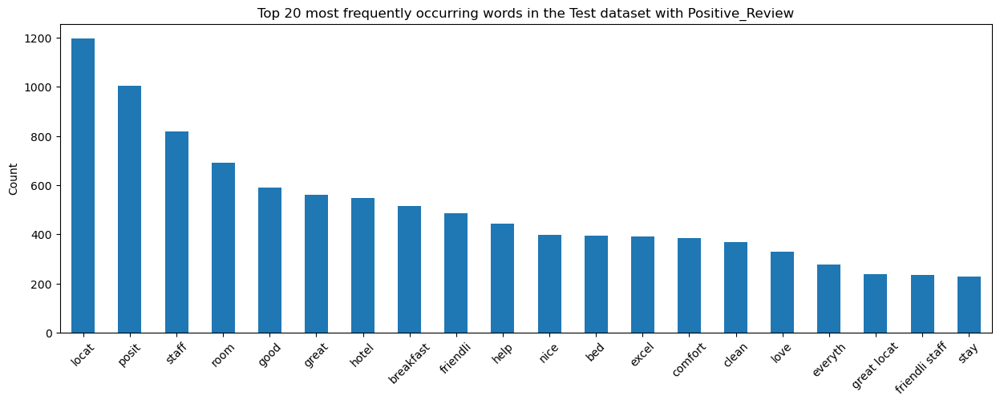

In [170]:
# Plot the top 20 frequesntly occuring words for TEST_TFIDF

word_counts = pd.DataFrame(
    {"counts": X_test_transformed_pos_tfidf.toarray().sum(axis=0)},
    index=tfidf_pos.get_feature_names()
).sort_values("counts", ascending=False)

word_counts.head(20).plot(kind="bar", figsize=(15, 5), legend=False)
plt.title("Top 20 most frequently occurring words in the Test dataset with Positive_Review")
plt.ylabel("Count")
plt.xticks(rotation=45)
plt.show()

Similar to CountVectorizer, the TF-IDF has similar results for both Train and Test dataset. However, the second most frequently words is posit as in positive. Other than that, all the words are similar, positive and uplifting words

#### 3d. Combining Negative_Review and Positive_Review to the main TRAIN and TEST dataframe

TF-IDF of both reviews columns will be used for the combination

In [242]:
# TRAIN

train_neg_tfidf = pd.DataFrame(columns=tfidf_neg.get_feature_names(), data=X_train_transformed_neg_tfidf.toarray())
train_pos_tfidf = pd.DataFrame(columns=tfidf_pos.get_feature_names(), data=X_train_transformed_pos_tfidf.toarray())

# Combinding the data

# Select X_train with KBest features
# must reset_index and drop columns index as the train is 67% of teh X dataset and didnt start index at 0
X_train3d = X_train[[' Cabin Single Room', ' Camper Room', ' Camper Suite',
       ' Deluxe Double', ' Deluxe Single Room',
       ' Deluxe Two Bedroom Apartment', ' Double Hilton Guestroom',
       ' Double Room with Shared Bathroom', ' Economy Twin Room',
       ' Grand Deluxe Double or Twin', ' Kings Junior Suite',
       ' Small Single Room', ' Standard Double',
       ' Standard Double Room without Window',
       ' Superior King or Twin Room', ' Superior Shard King',
       'Additional_Number_of_Scoring', 'Hotel_Name_LE', 'Reviewer_Score',
       'Total_Number_of_Reviews']].reset_index().drop(columns='index') 


# Concat the TF_IDF dataframes to the X_trained3d
X_train3d = pd.concat([X_train3d, train_neg_tfidf, train_pos_tfidf ], axis=1)


In [273]:
# Check
X_train3d.isna().sum()

 Cabin Single Room     0
 Camper Room           0
 Camper Suite          0
 Deluxe Double         0
 Deluxe Single Room    0
                      ..
work                   0
worth                  0
would                  0
would definit          0
year                   0
Length: 757, dtype: int64

In [245]:
# TEST

test_neg_tfidf = pd.DataFrame(columns=tfidf_neg.get_feature_names(), data=X_test_transformed_neg_tfidf.toarray())
test_pos_tfidf = pd.DataFrame(columns=tfidf_pos.get_feature_names(), data=X_test_transformed_pos_tfidf.toarray())

# Combinding the data

# Select X_train with KBest features
# must reset_index and drop columns index as the train is 33% of teh X dataset and didnt start index at 0
X_test3d = X_test[[' Cabin Single Room', ' Camper Room', ' Camper Suite',
       ' Deluxe Double', ' Deluxe Single Room',
       ' Deluxe Two Bedroom Apartment', ' Double Hilton Guestroom',
       ' Double Room with Shared Bathroom', ' Economy Twin Room',
       ' Grand Deluxe Double or Twin', ' Kings Junior Suite',
       ' Small Single Room', ' Standard Double',
       ' Standard Double Room without Window',
       ' Superior King or Twin Room', ' Superior Shard King',
       'Additional_Number_of_Scoring', 'Hotel_Name_LE', 'Reviewer_Score',
       'Total_Number_of_Reviews']].reset_index().drop(columns='index') 

# Concat the TF_IDF dataframes to the X_trained3d
X_test3d = pd.concat([X_test3d, test_neg_tfidf, test_pos_tfidf], axis=1)

In [267]:
# Check
X_test3d

,Cabin Single Room,Camper Room,Camper Suite,Deluxe Double,Deluxe Single Room,Deluxe Two Bedroom Apartment,Double Hilton Guestroom,Double Room with Shared Bathroom,Economy Twin Room,Grand Deluxe Double or Twin,...,within,within walk,within walk distanc,without,wonder,work,worth,would,would definit,year
0,0,0,0,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0,0,0,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0,0,0,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0,0,0,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0,0,0,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13597,0,0,0,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
13598,0,0,0,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
13599,0,0,0,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
13600,0,0,0,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [286]:
# Perform a LogReg Test to check for accuracy of test and train dataset:

y_train = y_train.reset_index().drop(columns='index').astype(int)

# Fitting a model
logreg = LogisticRegression(max_iter=10000)
logreg.fit(X_train3d, y_train)

# Training and test score
#print(f"Train score: {logreg.score(X_train3d, y_train.values.ravel())}")
#print(f"Test score: {logreg.score(X_test3d, y_test.reset_index().drop(columns='index') )}")

c:\Users\ethai\anaconda3\envs\timeseries\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().



KeyboardInterrupt: 

In [280]:
y_train.values

array([[7. ],
       [8.9],
       [8.3],
       ...,
       [8. ],
       [9.3],
       [8. ]])

Now there are 2 X dataframes: X_trained3d and X_test3d. These 2 dataframes have the exacts features (aka. same columns) that were concatenated to their own X_train and X_test from the TRAIN and TEST TF_IDF Vectorizer respectively. The main difference between the two dataframes is that the X_trained3d contained 67% of the X dataset and X_test3d contained 33% of the X dataset as set in the test_size. 



#### 3e. The importance of min_df in NLP

min_df is a parameter to exclude any token that occurs in less than min_df documents. For example, a corpus of 100 documents. min_df = 10 will exclude all the tokens that occur in less than 10 documents in a corpus. Thus, reducing noise and insignificant tokens.